# **PROJECT IDS 575: TWEETS SENTIMENTAL ANALYSIS**

## **LOADING LIBRARIES AND FILES**

**IMPORTING LIBRARIES**

In [2]:
import numpy as np
import pandas as pd
import re
import nltk
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.corpus import stopwords
from nltk.corpus import wordnet
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.naive_bayes import MultinomialNB
import sklearn.metrics as m
from sklearn.metrics import accuracy_score

import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
from sklearn.model_selection import GridSearchCV

from sklearn.svm import SVC
import time
import pandas as pd

import warnings
import sklearn.exceptions
warnings.filterwarnings("ignore", category=sklearn.exceptions.UndefinedMetricWarning)

In [5]:
# KMeans
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans

**LOADING FILES**

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
%cd /content/drive/My Drive/IDS 575

/content/drive/My Drive/IDS 575


In [8]:
!ls
!pwd

 articles.test		     'Quiz02PA_Question (1).py'
 articles.train		      Quiz03PA.py
'ids 561 report.gdoc'	     'Referral code.ipynb'
'IDS-575-Final Report.gdoc'   training-Obama-Romney-tweets.xlsx
 IDS575PA4.ipynb	      word2vec.model
 Quiz01PA.py		      words.map.txt
/content/drive/My Drive/IDS 575


In [9]:
tweet_file = pd.ExcelFile('training-Obama-Romney-tweets.xlsx')

In [10]:
obama = pd.read_excel('training-Obama-Romney-tweets.xlsx', sheet_name = 'Obama')
romney = pd.read_excel('training-Obama-Romney-tweets.xlsx', sheet_name = 'Romney')


## **DATA EXPLORATION**

In [11]:
print(obama)

      Unnamed: 0                 date            time  \
0            NaN                  NaN             NaN   
1            NaN  2012-10-16 00:00:00  10:28:53-05:00   
2            NaN  2016-12-10 00:00:00  10:09:00-05:00   
3            NaN  2012-10-16 00:00:00  10:04:30-05:00   
4            NaN  2012-10-16 00:00:00  10:00:36-05:00   
...          ...                  ...             ...   
7194         NaN           10/17/2012      AM 11:7:09   
7195         NaN           10/17/2012      AM 11:9:13   
7196         NaN           10/17/2012     AM 11:11:34   
7197         NaN           10/17/2012     AM 11:13:16   
7198         NaN           10/17/2012     AM 11:13:59   

                                        Anootated tweet Unnamed: 4  Unnamed: 5  
0       1: positive, -1: negative, 0: neutral, 2: mixed      Class  Your class  
1     Kirkpatrick, who wore a baseball cap embroider...          0         NaN  
2     Question: If <e>Romney</e> and <e>Obama</e> ha...          2      

In [12]:
# CLeaning the datasets 
df1  = obama.drop(['Unnamed: 0', 'date', 'time', 'Unnamed: 5'], axis=1)
df1 = df1.drop(labels=0, axis=0)
df1 = df1.rename({'Unnamed: 4': 'class','Anootated tweet':'tweet'}, axis=1)
df1 = df1[['tweet', 'class']]

df2  = romney.drop(['Unnamed: 0', 'date', 'time', 'Unnamed: 5'], axis=1)
df2 = df2.drop(labels=0, axis=0)
df2 = df2.rename({'Unnamed: 4': 'class','Anootated tweet':'tweet'}, axis=1)
df2 = df2[['tweet', 'class']]


**COMBINING THE DATASET**

In [13]:
# Concatenate the files for Obama tweets and Romney tweets
df1 = df1.append(df2)
df1 = df1.reset_index()
df1 = df1.drop(columns ='index')
df1

,tweet,class
0,"Kirkpatrick, who wore a baseball cap embroider...",0
1,Question: If <e>Romney</e> and <e>Obama</e> ha...,2
2,#<e>obama</e> debates that Cracker Ass Cracker...,1
3,RT @davewiner Slate: Blame <e>Obama</e> for fo...,2
4,@Hollivan @hereistheanswer Youre missing the ...,0
...,...,...
14393,"CNN's John King: After Two Debates"""" <e>Romney...",1
14394,el 59 por ciento de las mujeres blancas casada...,0
14395,@FedericoArreola No vimos perder a <e>Romney</...,2
14396,"""And they brought us a whole binder of women""""...",-1


In [14]:
# Unique values of the class output
df1['class'].unique()

array([0, 2, 1, -1, 'irrelevant', 'irrevelant', nan, '0', '2', '-1', '1',
       '!!!!', 'IR'], dtype=object)

In [15]:
df1.shape

(14398, 2)

In [16]:
# Finding the missing values 
df1.isna().sum()

tweet     2
class    34
dtype: int64

## **DATA PRE PROCESSING**

In [17]:
# Filtering out the dataset from the irrelevant and null values 
df1.drop(df1[df1['class'] == 'irrevelant' ].index, inplace = True)
df1.drop(df1[df1['class'] == 'irrelevant' ].index, inplace = True)
df1.drop(df1[df1['class'] == 'IR' ].index, inplace = True)
df1.drop(df1[df1['class'] == '!!!!' ].index, inplace = True)
df1.drop(df1[df1['class'].isnull()].index, inplace = True)
df1.drop(df1[df1['tweet'].isnull()].index, inplace = True)

# Converting the class types input to all integers (uniform)
df1['class'] = df1['class'].astype(int)
df1 = df1.reset_index()

df1['class'] = df1['class'].replace(2,0)

# Counted the data for each class
df1.groupby('class').nunique()

,index,tweet
class,,
-1,4861,4850
0,6551,6541
1,2754,2746


**The data would be trained on the following sentiment:**
-1 : Negative sentiment 
0: Neutral sentiment 
1 : Positive sentiment 

In [18]:
df1[df1['class'] == 0].head(10)

,index,tweet,class
0,0,"Kirkpatrick, who wore a baseball cap embroider...",0
1,1,Question: If <e>Romney</e> and <e>Obama</e> ha...,0
3,3,RT @davewiner Slate: Blame <e>Obama</e> for fo...,0
4,4,@Hollivan @hereistheanswer Youre missing the ...,0
5,5,<e>Mitt Romney</e> made all of his money himse...,0
7,7,The <e>Obama camp</e> can't afford to lower ex...,0
8,8,"Tonight's debate has that ""Game 7"" feel! This ...",0
11,11,@hblodget i'd be grateful for scoop from you g...,0
12,12,"<e>Obama</e> must, to a degree, hit <e>MR</e> ...",0
13,13,<e>Obama</e>'s Expedient Speak fair in order t...,0


## **CLEANING TWEETS**

In [19]:
def depure_data(data):
    
    #Removing URLs with a regular expression
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    data = url_pattern.sub(r'', data)

    # Remove Emails
    data = re.sub('\S*@\S*\s?', '', data)

    # Remove new line characters
    data = re.sub('\s+', ' ', data)

    # Remove distracting single quotes
    data = re.sub("\'", "", data)
        
    return data

df1['Cleaned_tweets'] = df1['tweet'].apply(depure_data)


In [20]:
def striphtml(data):
    p = re.compile(r'<.*?>')
    return p.sub('', str(data))
df1['New'] = df1['Cleaned_tweets'].apply(striphtml)


def clean(text):
# Removes all special characters and numericals leaving the alphabets
    text = re.sub('[^A-Za-z]+', ' ', str(text))
    text = text.lower()
    return text

# Cleaning the text in the review column
df1['ultra_Cleaned_tweets'] = df1['New'].apply(clean)

df1 = df1.drop(columns = ['tweet', 'Cleaned_tweets', 'New', 'index'])
df1 = df1.rename(columns={'ultra_Cleaned_tweets': 'tweet'})

## **TEXT NORMALIZATION**

**1. IDENTIFYING PART OF SPEECH FOR THE TWEETS**

In [21]:
nltk.download('omw-1.4')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [22]:
# POS tagger dictionary
pos_dict = {'J':wordnet.ADJ, 'V':wordnet.VERB, 'N':wordnet.NOUN, 'R':wordnet.ADV}
def token_stop_pos(text):
    tags = pos_tag(word_tokenize(text))
    newlist = []
    for word, tag in tags:
        if word.lower() not in set(stopwords.words('english')):
            newlist.append(tuple([word, pos_dict.get(tag[0])]))
    return newlist

df1['POS_tagged'] = df1['tweet'].apply(token_stop_pos)

**2. LEMMATIZING TWEETS** 

In [23]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
def lemmatize(pos_data):
    lemma_rew = " "
    for word, pos in pos_data:
        if not pos:
            lemma = word
            lemma_rew = lemma_rew + " " + lemma
        else:
            lemma = wordnet_lemmatizer.lemmatize(word, pos=pos)
            lemma_rew = lemma_rew + " " + lemma
    return lemma_rew

df1['Lemma'] = df1['POS_tagged'].apply(lemmatize)

In [24]:
# tokenizing the words present in the training set
df1['tokenized_tweet'] = df1['Lemma'].apply(lambda x: x.split()) 

In [25]:
df1

,class,tweet,POS_tagged,Lemma,tokenized_tweet
0,0,kirkpatrick who wore a baseball cap embroidere...,"[(kirkpatrick, n), (wore, v), (baseball, n), (...",kirkpatrick wear baseball cap embroider bara...,"[kirkpatrick, wear, baseball, cap, embroider, ..."
1,0,question if romney and obama had a child punch...,"[(question, n), (romney, n), (obama, n), (chil...",question romney obama child punch contest mi...,"[question, romney, obama, child, punch, contes..."
2,1,obama debates that cracker ass cracker tonigh...,"[(obama, n), (debates, v), (cracker, n), (ass,...",obama debate cracker as cracker tonight tune...,"[obama, debate, cracker, as, cracker, tonight,..."
3,0,rt slate blame obama for four deaths in libya ...,"[(rt, n), (slate, n), (blame, n), (obama, n), ...",rt slate blame obama four death libya dont b...,"[rt, slate, blame, obama, four, death, libya, ..."
4,0,youre missing the point im afraid you do not ...,"[(youre, n), (missing, v), (point, n), (im, n)...",youre miss point im afraid understand big pi...,"[youre, miss, point, im, afraid, understand, b..."
...,...,...,...,...,...
14161,1,cnns john king after two debates romney still ...,"[(cnns, n), (john, n), (king, n), (two, None),...",cnns john king two debate romney still plus ...,"[cnns, john, king, two, debate, romney, still,..."
14162,0,el por ciento de las mujeres blancas casadas r...,"[(el, n), (por, n), (ciento, n), (de, None), (...",el por ciento de las mujeres blancas casadas...,"[el, por, ciento, de, las, mujeres, blancas, c..."
14163,0,no vimos perder a romneyante obama por lo que ...,"[(vimos, n), (perder, v), (romneyante, n), (ob...",vimos perder romneyante obama por lo que dor...,"[vimos, perder, romneyante, obama, por, lo, qu..."
14164,-1,and they brought us a whole binder of women o...,"[(brought, v), (us, None), (whole, a), (binder...",bring us whole binder woman oh romney,"[bring, us, whole, binder, woman, oh, romney]"


## **VISUALISATIONS**

Text(0, 0.5, 'Sentiment Count')

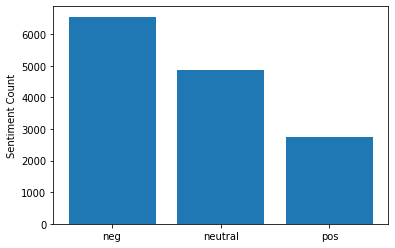

In [ ]:
# Plot frequency graph of tweets for different classes
mood_count = df1['class'].value_counts()
Index = [1,2,3]
plt.bar(Index, mood_count)
plt.xticks(Index, ['neg', 'neutral', 'pos'])
plt.ylabel('Sentiment Count')

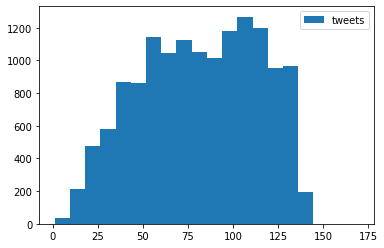

In [ ]:
# Frequency of tweets 
freq = df1['tweet'].str.len()  
plt.hist(freq, bins=20, label="tweets") 
plt.legend() 
plt.show()

In [ ]:
# adding a column to represent the length of the tweet

df1['len'] = df1['tweet'].str.len()
df1.head(10)

,class,len,tweet,POS_tagged,Lemma,tokenized_tweet
0,0,132,kirkpatrick who wore a baseball cap embroidere...,"[(kirkpatrick, n), (wore, v), (baseball, n), (...",kirkpatrick wear baseball cap embroider bara...,"[kirkpatrick, wear, baseball, cap, embroider, ..."
1,0,111,question if romney and obama had a child punch...,"[(question, n), (romney, n), (obama, n), (chil...",question romney obama child punch contest mi...,"[question, romney, obama, child, punch, contes..."
2,1,76,obama debates that cracker ass cracker tonigh...,"[(obama, n), (debates, v), (cracker, n), (ass,...",obama debate cracker as cracker tonight tune...,"[obama, debate, cracker, as, cracker, tonight,..."
3,0,96,rt slate blame obama for four deaths in libya ...,"[(rt, n), (slate, n), (blame, n), (obama, n), ...",rt slate blame obama four death libya dont b...,"[rt, slate, blame, obama, four, death, libya, ..."
4,0,112,youre missing the point im afraid you do not ...,"[(youre, n), (missing, v), (point, n), (im, n)...",youre miss point im afraid understand big pi...,"[youre, miss, point, im, afraid, understand, b..."
5,0,109,mitt romney made all of his money himself bara...,"[(mitt, n), (romney, n), (made, v), (money, n)...",mitt romney make money barack obama make mon...,"[mitt, romney, make, money, barack, obama, mak..."
6,-1,130,i was raised as a democrat left the party year...,"[(raised, v), (democrat, n), (left, v), (party...",raise democrat leave party year ago lifetime...,"[raise, democrat, leave, party, year, ago, lif..."
7,0,114,the obama camp cant afford to lower expectatio...,"[(obama, n), (camp, n), (cant, n), (afford, n)...",obama camp cant afford low expectation tonig...,"[obama, camp, cant, afford, low, expectation, ..."
8,0,128,tonights debate has that game feel this is it ...,"[(tonights, n), (debate, n), (game, n), (feel,...",tonight debate game feel pres obama call rom...,"[tonight, debate, game, feel, pres, obama, cal..."
9,-1,62,obama pot policy disappointing to say the leas...,"[(obama, n), (pot, n), (policy, n), (disappoin...",obama pot policy disappoint say least legaiz...,"[obama, pot, policy, disappoint, say, least, l..."


In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'Most Frequently Occuring Words - Top 30')

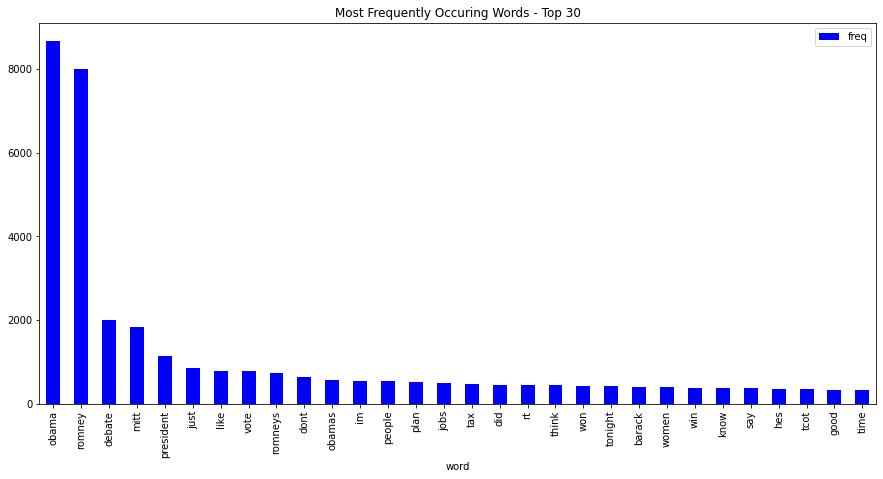

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt

cv = CountVectorizer(stop_words = 'english')
words = cv.fit_transform(df1.tweet)

sum_words = words.sum(axis=0)

words_freq = [(word, sum_words[0, i]) for word, i in cv.vocabulary_.items()]
words_freq = sorted(words_freq, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(words_freq, columns=['word', 'freq'])

frequency.head(30).plot(x='word', y='freq', kind='bar', figsize=(15, 7), color = 'blue')
plt.title("Most Frequently Occuring Words - Top 30")

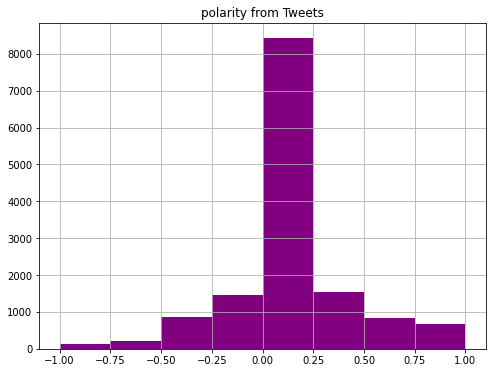

In [ ]:
from textblob import TextBlob
import matplotlib.pyplot as plt

def analysis(data):    
    res = TextBlob(data).sentiment
    return res
def pol(res):
    return res.polarity
df1['TextBlob'] = df1['Lemma'].apply(analysis)
df1['polarity'] = df1['TextBlob'].apply(pol)
# print(df1.TextBlob[1])

fig, ax = plt.subplots(figsize=(8, 6))
df1.polarity.hist(bins=[-1, -0.75, -0.5, -0.25, 0.0, 0.25, 0.5, 0.75, 1],
             ax=ax,
             color="purple")

plt.title("polarity from Tweets")
plt.show()

**POSITIVE WORDCLOUD**

In [ ]:
positive = df1[df1['class'] == 1]

In [ ]:
cv = CountVectorizer(stop_words = 'english')
words = cv.fit_transform(positive.tweet)

sum_words = words.sum(axis=0)

words_freq_pos = [(word, sum_words[0, i]) for word, i in cv.vocabulary_.items()]
words_freq_pos = sorted(words_freq_pos, key = lambda x: x[1], reverse = True)

In [ ]:
words_freq_pos.sort(key = lambda i:i[1], reverse = True)
words_freq_pos

[('obama', 1859),
 ('romney', 1149),
 ('debate', 439),
 ('president', 320),
 ('mitt', 258),
 ('vote', 252),
 ('won', 234),
 ('just', 150),
 ('tonight', 148),
 ('win', 148),
 ('im', 129),
 ('good', 110),
 ('dont', 104),
 ('did', 99),
 ('like', 97),
 ('voting', 96),
 ('poll', 89),
 ('election', 88),
 ('wins', 85),
 ('think', 85),
 ('great', 83),
 ('rt', 76),
 ('people', 75),
 ('barack', 75),
 ('job', 72),
 ('better', 70),
 ('time', 68),
 ('got', 68),
 ('obamas', 67),
 ('going', 66),
 ('say', 65),
 ('america', 61),
 ('hes', 59),
 ('tcot', 59),
 ('support', 58),
 ('debates', 57),
 ('right', 57),
 ('women', 57),
 ('know', 56),
 ('really', 55),
 ('said', 53),
 ('jobs', 53),
 ('romneys', 53),
 ('ryan', 51),
 ('economy', 48),
 ('make', 46),
 ('presidential', 46),
 ('states', 46),
 ('man', 45),
 ('love', 45),
 ('hope', 44),
 ('best', 43),
 ('says', 43),
 ('years', 42),
 ('want', 42),
 ('lead', 42),
 ('plan', 40),
 ('news', 40),
 ('way', 40),
 ('polls', 40),
 ('today', 39),
 ('need', 39),
 ('nig

In [ ]:
words_freq_pos = words_freq_pos[8:]

Text(0.5, 1.0, 'WordCloud - Vocabulary from Reviews')

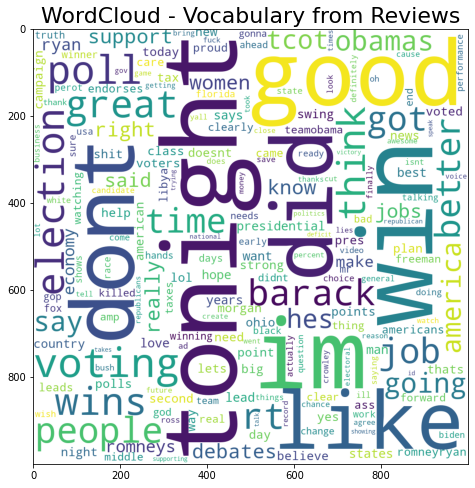

In [ ]:
from wordcloud import WordCloud

wordcloud = WordCloud(background_color = 'white', width = 1000, height = 1000).generate_from_frequencies(dict(words_freq_pos))

plt.figure(figsize=(10,8))
plt.imshow(wordcloud)
plt.title("WordCloud - Vocabulary from Reviews", fontsize = 22)

**NEGATIVE WORDCLOUD**

In [ ]:
negative = df1[df1['class'] == -1]

In [ ]:
cv = CountVectorizer(stop_words = 'english')
words = cv.fit_transform(negative.tweet)

sum_words = words.sum(axis=0)

words_freq_neg = [(word, sum_words[0, i]) for word, i in cv.vocabulary_.items()]
words_freq_neg = sorted(words_freq_neg, key = lambda x: x[1], reverse = True)

In [ ]:
words_freq_neg.sort(key = lambda i:i[1], reverse = True)
words_freq_neg

[('romney', 2634),
 ('obama', 2047),
 ('mitt', 755),
 ('debate', 433),
 ('like', 332),
 ('romneys', 331),
 ('president', 304),
 ('just', 300),
 ('jobs', 275),
 ('dont', 264),
 ('plan', 247),
 ('vote', 236),
 ('people', 230),
 ('tax', 210),
 ('women', 204),
 ('obamas', 195),
 ('im', 179),
 ('rt', 153),
 ('hes', 152),
 ('think', 149),
 ('doesnt', 149),
 ('lies', 146),
 ('really', 143),
 ('tcot', 140),
 ('know', 137),
 ('did', 129),
 ('ryan', 129),
 ('america', 126),
 ('said', 113),
 ('say', 110),
 ('going', 107),
 ('does', 106),
 ('time', 106),
 ('china', 102),
 ('care', 98),
 ('make', 97),
 ('sensata', 97),
 ('years', 95),
 ('debates', 95),
 ('want', 94),
 ('good', 94),
 ('libya', 92),
 ('job', 89),
 ('class', 89),
 ('says', 89),
 ('voting', 89),
 ('got', 88),
 ('didnt', 88),
 ('wins', 87),
 ('shit', 85),
 ('amp', 85),
 ('americans', 85),
 ('man', 85),
 ('new', 84),
 ('lying', 84),
 ('liar', 84),
 ('win', 82),
 ('american', 82),
 ('election', 81),
 ('right', 81),
 ('lol', 81),
 ('fuck',

In [ ]:
words_freq_neg = words_freq_neg[6:]

Text(0.5, 1.0, 'WordCloud - Vocabulary from Reviews')

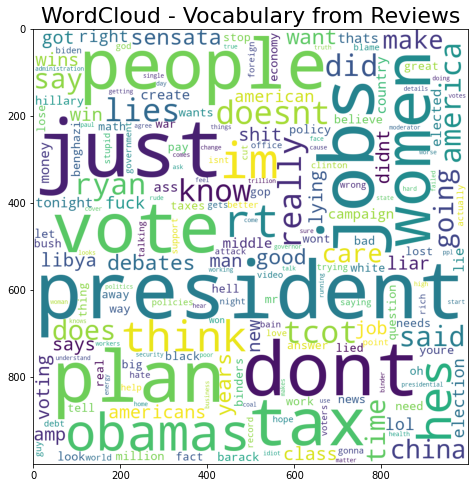

In [ ]:
from wordcloud import WordCloud

wordcloud = WordCloud(background_color = 'white', width = 1000, height = 1000).generate_from_frequencies(dict(words_freq_neg))

plt.figure(figsize=(10,8))
plt.imshow(wordcloud)
plt.title("WordCloud - Vocabulary from Reviews", fontsize = 22)

## **WORD2VECTOR GENSIM MODEL**

In [26]:
# importing gensim
import gensim
from gensim.models import Word2Vec, KeyedVectors
import nltk

import logging

# PCA
from sklearn.decomposition import PCA

In [27]:
# Split the data into train and test data set 
x_train, x_test , y_train, y_test = train_test_split(df1['tokenized_tweet'].values,df1['class'].values,test_size=0.2,random_state=123,stratify=df1['class'].values)

In [28]:
#learning word embeddings on training data using Gensim library
embeddingsSize=128
model=Word2Vec(x_train, size=embeddingsSize, window=5, min_count=1, workers=4)

#Training of Word Embeddings Vector Completed

In [29]:
# creating a word to vector model
model_w2v = gensim.models.Word2Vec(
            df1['tokenized_tweet'],
            size=200, # desired no. of features/independent variables 
            window=5, # context window size
            min_count=2,
            sg = 1, # 1 for skip-gram model
            hs = 0,
            negative = 10, # for negative sampling
            workers= 2, # no.of cores
            seed = 34)

model_w2v.train(df1['tokenized_tweet'], total_examples= len(df1['Lemma']), epochs=20)

(2031991, 2642080)

In [30]:
# Saving the mdoel
model_w2v.save("word2vec.model")

In [31]:
# Running the model to find similar words to Obama
model_w2v.wv.most_similar('obama')

[('yooooo', 0.5516119599342346),
 ('obamageneral', 0.5514117479324341),
 ('preacher', 0.5492688417434692),
 ('sityoassdown', 0.5490788817405701),
 ('noagenda', 0.5403099060058594),
 ('mckinnon', 0.5364784002304077),
 ('itz', 0.5359516143798828),
 ('duel', 0.5352441072463989),
 ('agressive', 0.5288659334182739),
 ('embarrassed', 0.5288206338882446)]

### **VISUALISATION OF WORD VECTORS**

**CREATION OF VOCABULARY WORDS**

In [ ]:
#list the vocabulary words
words = list(model_w2v.wv.vocab)
print(words)
#or show the dictionary of vocab words
model_w2v.wv.vocab

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


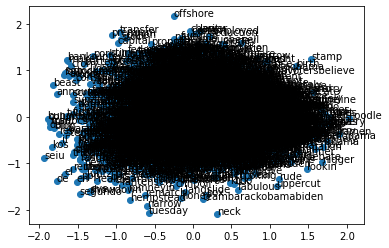

In [ ]:
# Using PCA to cluster words
X = model_w2v[model_w2v.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
# create a scatter plot of the projection
plt.scatter(result[:, 0], result[:, 1])
words = list(model_w2v.wv.vocab)
for i, word in enumerate(words):
    plt.annotate(word, xy=(result[i, 0], result[i, 1]))
plt.show()

**This is way too clumsy.** 
So we use plotpy instead of matplotlib for better interactive visualisation. 

In [ ]:
#pass the embeddings to PCA
X = model_w2v[model_w2v.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])
#add the words for the hover effect
pca_df['word'] = words
pca_df.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


,x,y,word
0,0.722200,-1.289936,wear
1,-0.011763,0.940228,cap
2,-0.332929,-0.956066,barack
3,-0.104813,0.218070,obamas
4,0.158216,-0.477887,signature


In [ ]:
import plotly.graph_objects as go
N = 1000000
words = list(model_w2v.wv.vocab)
fig = go.Figure(data=go.Scattergl(
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    text=pca_df['word'],
    textposition="bottom center"
))
fig.show()

### **BAG OF WORDS**

This is a common way of averaging the two words vectors.

In [32]:
print(gensim.__version__)

3.6.0


**Data Pre-processing for Model Buidling** 

In [33]:
# Averaging the word vectors
def word_averaging(wv, words):
    all_words, mean = set(), []
    
    for word in words:
        if isinstance(word, np.ndarray):
            mean.append(word)
        elif word in wv.wv.vocab:
            mean.append(wv.wv.syn0norm[wv.wv.vocab[word].index])
            all_words.add(wv.wv.vocab[word].index)

    if not mean:
        logging.warning("cannot compute similarity with no input %s", words)
        # FIXME: remove these examples in pre-processing
        return np.zeros(wv.vector_size,)

    mean = gensim.matutils.unitvec(np.array(mean).mean(axis=0)).astype(np.float32)
    return mean

def  word_averaging_list(wv, text_list):
    return np.vstack([word_averaging(wv, post) for post in text_list ])

In [34]:
# Tokenize the tweets
def w2v_tokenize_text(text):
    tokens = []
    for sent in nltk.sent_tokenize(text, language='english'):
        for word in nltk.word_tokenize(sent, language='english'):
            if len(word) < 2:
                continue
            tokens.append(word)
    return tokens
    
train, test = train_test_split(df1, test_size=0.3, random_state = 42)

test_tokenized = test.apply(lambda r: w2v_tokenize_text(r['Lemma']), axis=1).values
train_tokenized = train.apply(lambda r: w2v_tokenize_text(r['Lemma']), axis=1).values

X_train_word_average = word_averaging_list(model_w2v,train_tokenized)
X_test_word_average = word_averaging_list(model_w2v,test_tokenized)

<ipython-input-33-aa70e1ccb5c7>:9: DeprecationWarning: Call to deprecated `syn0norm` (Attribute will be removed in 4.0.0, use self.wv.vectors_norm instead).
  mean.append(wv.wv.syn0norm[wv.wv.vocab[word].index])


### **LOGISTIC REGRESSION (BASED ON WORD2VECT)**

In [ ]:
logreg = LogisticRegression(n_jobs=1, C=1e5)
logreg = logreg.fit(X_train_word_average, train['class'])
y_pred = logreg.predict(X_test_word_average)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
print('accuracy %s' % accuracy_score(y_pred, test['class']))
print(classification_report(test['class'], y_pred))

accuracy 0.5745882352941176
              precision    recall  f1-score   support

          -1       0.56      0.53      0.54      1461
           0       0.60      0.70      0.64      1988
           1       0.53      0.35      0.42       801

    accuracy                           0.57      4250
   macro avg       0.56      0.53      0.54      4250
weighted avg       0.57      0.57      0.57      4250



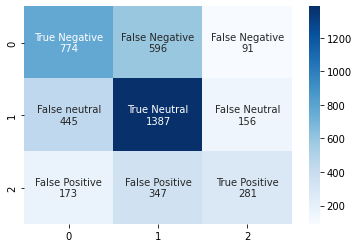

In [ ]:
cnf_matrix = confusion_matrix(test['class'],y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **DECISION TREE (BASED ON WORD2VECT)**

In [ ]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X_train_word_average, train['class'])
y_pred= clf.predict(X_test_word_average)

[Text(0.5, 0.875, 'X[24] <= -0.014\ngini = 0.632\nsamples = 9916\nvalue = [3400, 4563, 1953]'),
 Text(0.25, 0.625, 'X[67] <= -0.105\ngini = 0.619\nsamples = 5661\nvalue = [2442, 2341, 878]'),
 Text(0.125, 0.375, 'X[198] <= 0.059\ngini = 0.611\nsamples = 2124\nvalue = [724, 1054, 346]'),
 Text(0.0625, 0.125, '\n  (...)  \n'),
 Text(0.1875, 0.125, '\n  (...)  \n'),
 Text(0.375, 0.375, 'X[29] <= 0.054\ngini = 0.609\nsamples = 3537\nvalue = [1718, 1287, 532]'),
 Text(0.3125, 0.125, '\n  (...)  \n'),
 Text(0.4375, 0.125, '\n  (...)  \n'),
 Text(0.75, 0.625, 'X[63] <= 0.114\ngini = 0.613\nsamples = 4255\nvalue = [958, 2222, 1075]'),
 Text(0.625, 0.375, 'X[194] <= -0.036\ngini = 0.602\nsamples = 3921\nvalue = [920, 2122, 879]'),
 Text(0.5625, 0.125, '\n  (...)  \n'),
 Text(0.6875, 0.125, '\n  (...)  \n'),
 Text(0.875, 0.375, 'X[127] <= 0.001\ngini = 0.553\nsamples = 334\nvalue = [38, 100, 196]'),
 Text(0.8125, 0.125, '\n  (...)  \n'),
 Text(0.9375, 0.125, '\n  (...)  \n')]

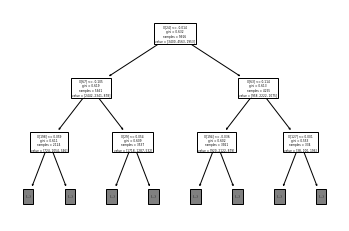

In [ ]:
tree.plot_tree(clf, max_depth =2)

In [ ]:
print(m.classification_report(test['class'],y_pred))

              precision    recall  f1-score   support

          -1       0.45      0.43      0.44      1461
           0       0.53      0.52      0.53      1988
           1       0.30      0.34      0.32       801

    accuracy                           0.46      4250
   macro avg       0.43      0.43      0.43      4250
weighted avg       0.46      0.46      0.46      4250



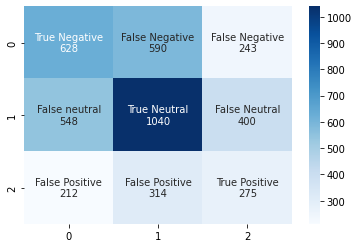

In [ ]:
cnf_matrix = confusion_matrix(test['class'],y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **RANDOM FOREST (BASED ON WORD2VECT)**

In [ ]:
classifier1 = RandomForestClassifier()
classifier1.fit(X_train_word_average, train['class'])

RandomForestClassifier()

In [ ]:
y_pred = classifier1.predict(X_test_word_average)

In [ ]:
m.accuracy_score(y_pred, test['class'])

0.5736470588235294

In [ ]:
print(classification_report(test['class'],y_pred))

              precision    recall  f1-score   support

          -1       0.55      0.54      0.54      1461
           0       0.57      0.74      0.65      1988
           1       0.71      0.22      0.34       801

    accuracy                           0.57      4250
   macro avg       0.61      0.50      0.51      4250
weighted avg       0.59      0.57      0.55      4250



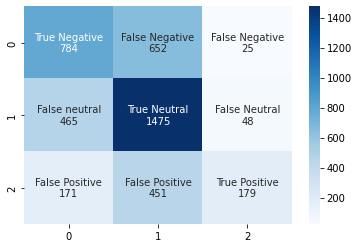

In [ ]:
cnf_matrix = confusion_matrix(test['class'],y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **SUPPORT VECTOR MACHINE (BASED ON WORD2VECT)**

In [ ]:
# cross_validation
tuned_parameters = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-4, 1e-5], 'C': [1, 10, 100]}, {'kernel': ['linear'], 'C': [1, 10, 100]}]

# train svm via cross validation
A = time.time()
clf = GridSearchCV(SVC(), tuned_parameters, cv=5, scoring='precision_weighted', verbose=15, n_jobs=-1)
clf.fit(X_train_word_average, train['class'])
print('Cross validation time: {}'.format(time.time() - A))
print("Best parameters set found on development set:")
print(clf.best_params_)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
Cross validation time: 889.1095335483551
Best parameters set found on development set:
{'C': 10, 'kernel': 'linear'}


In [ ]:
# Building SVM model using best parameters
svm_model = SVC(kernel='linear',  C=10)
svm_model.fit(X_train_word_average, train['class'])

SVC(C=10, kernel='linear')

In [ ]:
svm_pred = svm_model.predict(X_test_word_average)

In [ ]:
print(m.classification_report(test['class'],svm_pred))

              precision    recall  f1-score   support

          -1       0.55      0.57      0.56      1461
           0       0.60      0.71      0.65      1988
           1       0.61      0.29      0.39       801

    accuracy                           0.58      4250
   macro avg       0.59      0.52      0.53      4250
weighted avg       0.58      0.58      0.57      4250



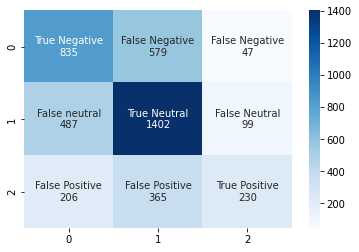

In [ ]:
cnf_matrix = confusion_matrix(test['class'],svm_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

## **K-NEAREST NEIGHBOURS (BASED ON WORD2VEC)**

In [35]:
neighbor = KNeighborsClassifier(n_neighbors=3)
y_pred = neighbor.fit(X_train_word_average,train['class']).predict(X_test_word_average)

In [36]:
print('Accuracy score:{0}'.format(accuracy_score(test['class'], y_pred)))
print(classification_report(test['class'], y_pred))

Accuracy score:0.5369411764705883
              precision    recall  f1-score   support

          -1       0.49      0.53      0.51      1461
           0       0.59      0.62      0.60      1988
           1       0.49      0.34      0.40       801

    accuracy                           0.54      4250
   macro avg       0.52      0.50      0.50      4250
weighted avg       0.53      0.54      0.53      4250



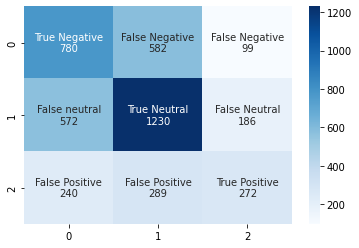

In [39]:
cnf_matrix_knn = confusion_matrix(test['class'], y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix_knn.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix_knn, annot=labels, fmt='', cmap='Blues');

## **TERM FREQUENCY - INVERSE DOCUMENT FREQUENCY VECTORISATION**

In [41]:
# Creating a array of lemmatized tweets
sample = df1['Lemma'].iloc[:2].values
sample

array(['  kirkpatrick wear baseball cap embroider barack obamas signature hangdog look jason segel courier journal',
       '  question romney obama child punch contest mitt punch five obama punch none'],
      dtype=object)

In [42]:
# Finding the term frequency in vector form 
count_vectorizer = CountVectorizer()
cv = count_vectorizer.fit_transform(sample)

doc_names = ['Doc{:d}'.format(idx) for idx, _ in enumerate(cv)]
feat_names = count_vectorizer.get_feature_names()

sample_df = pd.DataFrame(data=cv.toarray(), index=doc_names,columns=feat_names)
sample_df

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,barack,baseball,cap,child,contest,courier,embroider,five,hangdog,jason,...,mitt,none,obama,obamas,punch,question,romney,segel,signature,wear
Doc0,1,1,1,0,0,1,1,0,1,1,...,0,0,0,1,0,0,0,1,1,1
Doc1,0,0,0,1,1,0,0,1,0,0,...,1,1,2,0,3,1,1,0,0,0


In [43]:
# Split the data into train and test data set 
x_train, x_test , y_train, y_test = train_test_split(df1['Lemma'].values,df1['class'].values,test_size=0.2,random_state=123,stratify=df1['class'].values)

In [44]:
# Creating TF-IDF for Term Frequency for train and test data separately 
tfidf_vectorizer = TfidfVectorizer() 
tfidf_train_vectors = tfidf_vectorizer.fit_transform(x_train)
tfidf_test_vectors = tfidf_vectorizer.transform(x_test)

### **NAIVE BAYES**

In [ ]:
model_nb=MultinomialNB() 
model_nb.fit(tfidf_train_vectors,y_train)

MultinomialNB()

In [ ]:
label_pred=model_nb.predict(tfidf_test_vectors)
label_pred

array([ 0, -1, -1, ..., -1,  0,  0])

In [ ]:
m.accuracy_score(y_test,label_pred)

0.5282286520818631

In [ ]:
print(m.classification_report(y_test,label_pred))

              precision    recall  f1-score   support

          -1       0.59      0.40      0.48       972
           0       0.51      0.84      0.63      1311
           1       0.80      0.03      0.06       551

    accuracy                           0.53      2834
   macro avg       0.63      0.42      0.39      2834
weighted avg       0.59      0.53      0.47      2834



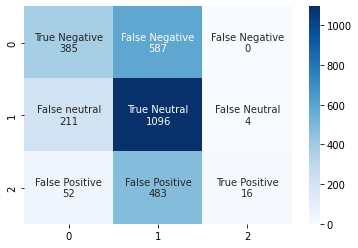

In [ ]:
cnf_matrix = confusion_matrix(y_test,label_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **LOGISTIC REGRESSION**

In [ ]:
logreg = LogisticRegression(n_jobs=1, C=1e5)
logreg = logreg.fit(tfidf_train_vectors,y_train)
y_pred = logreg.predict(tfidf_test_vectors)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [ ]:
print(accuracy_score(y_test,y_pred))

0.5352858151023289


In [ ]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

          -1       0.55      0.53      0.54       972
           0       0.58      0.59      0.59      1311
           1       0.40      0.42      0.41       551

    accuracy                           0.54      2834
   macro avg       0.51      0.51      0.51      2834
weighted avg       0.54      0.54      0.54      2834



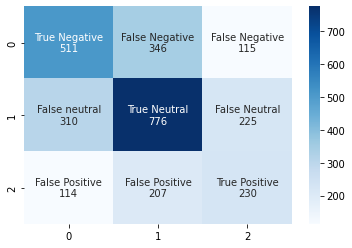

In [ ]:
cnf_matrix = confusion_matrix(y_test,y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **DECISION TREE**

In [ ]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(tfidf_train_vectors,y_train)
y_pred= clf.predict(tfidf_test_vectors)

[Text(0.5, 0.875, 'X[6214] <= 0.014\ngini = 0.631\nsamples = 11332\nvalue = [3889, 5240, 2203]'),
 Text(0.25, 0.625, 'X[5031] <= 0.251\ngini = 0.619\nsamples = 4854\nvalue = [2325, 1693, 836]'),
 Text(0.125, 0.375, 'X[6258] <= 0.065\ngini = 0.616\nsamples = 4809\nvalue = [2322, 1687, 800]'),
 Text(0.0625, 0.125, '\n  (...)  \n'),
 Text(0.1875, 0.125, '\n  (...)  \n'),
 Text(0.375, 0.375, 'X[10354] <= 0.102\ngini = 0.338\nsamples = 45\nvalue = [3, 6, 36]'),
 Text(0.3125, 0.125, '\n  (...)  \n'),
 Text(0.4375, 0.125, '\n  (...)  \n'),
 Text(0.75, 0.625, 'X[7765] <= 0.015\ngini = 0.597\nsamples = 6478\nvalue = [1564, 3547, 1367]'),
 Text(0.625, 0.375, 'X[6214] <= 0.134\ngini = 0.661\nsamples = 4161\nvalue = [1343, 1618, 1200]'),
 Text(0.5625, 0.125, '\n  (...)  \n'),
 Text(0.6875, 0.125, '\n  (...)  \n'),
 Text(0.875, 0.375, 'X[5111] <= 0.107\ngini = 0.293\nsamples = 2317\nvalue = [221, 1929, 167]'),
 Text(0.8125, 0.125, '\n  (...)  \n'),
 Text(0.9375, 0.125, '\n  (...)  \n')]

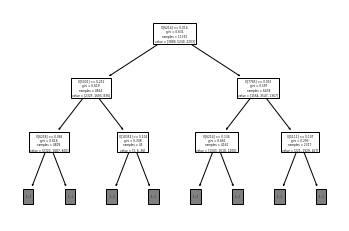

In [ ]:
tree.plot_tree(clf, max_depth =2)

In [ ]:
print(m.classification_report(y_test,y_pred))

              precision    recall  f1-score   support

          -1       0.54      0.52      0.53       972
           0       0.62      0.65      0.64      1311
           1       0.43      0.41      0.42       551

    accuracy                           0.56      2834
   macro avg       0.53      0.53      0.53      2834
weighted avg       0.56      0.56      0.56      2834



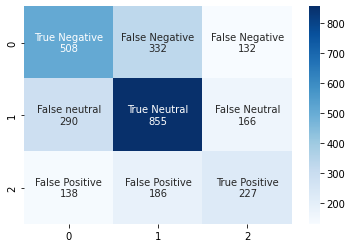

In [ ]:
cnf_matrix = confusion_matrix(y_test,y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **RANDOM FOREST CLASSIFIER** 

In [ ]:
classifier1 = RandomForestClassifier()
classifier1.fit(tfidf_train_vectors,y_train)

RandomForestClassifier()

In [ ]:
rf_pred = classifier1.predict(tfidf_test_vectors)

In [ ]:
print(accuracy_score(y_test,rf_pred))

0.6143260409315455


In [ ]:
print(classification_report(y_test,rf_pred))

              precision    recall  f1-score   support

          -1       0.60      0.60      0.60       972
           0       0.63      0.73      0.67      1311
           1       0.60      0.37      0.46       551

    accuracy                           0.61      2834
   macro avg       0.61      0.57      0.58      2834
weighted avg       0.61      0.61      0.61      2834



In [ ]:
cnf_matrix = confusion_matrix(y_test,rf_pred)
cnf_matrix

array([[587, 339,  46],
       [262, 958,  91],
       [115, 232, 204]])

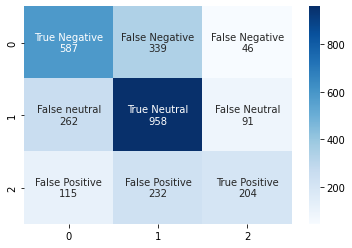

In [ ]:
cnf_matrix = confusion_matrix(y_test,rf_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

### **K NEAREST NEIGHBOURS**

In [45]:
neighbor = KNeighborsClassifier(n_neighbors=3)
# KNeighborsClassifier(tfidf_train_vectors,y_train)
y_pred = neighbor.fit(tfidf_train_vectors,y_train).predict(tfidf_test_vectors)

In [46]:
print('Accuracy score:{0}'.format(accuracy_score(y_test, y_pred)))
print(classification_report(y_test, y_pred))

Accuracy score:0.507410021171489
              precision    recall  f1-score   support

          -1       0.55      0.14      0.22       972
           0       0.49      0.91      0.64      1311
           1       0.64      0.20      0.31       551

    accuracy                           0.51      2834
   macro avg       0.56      0.42      0.39      2834
weighted avg       0.54      0.51      0.43      2834



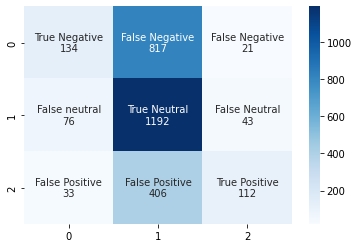

In [48]:
cnf_matrix_knn = confusion_matrix(y_test, y_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix_knn.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix_knn, annot=labels, fmt='', cmap='Blues');

### **SUPPORT VECTOR MACHINE**

In [ ]:
# cross_validation
tuned_parameters = [{'kernel': ['rbf'], 'gamma': [1e-3, 1e-4, 1e-5], 'C': [1, 10, 100]}, {'kernel': ['linear'], 'C': [1, 10, 100]}]

# train svm via cross validation
A = time.time()
clf = GridSearchCV(SVC(), tuned_parameters, cv=5, scoring='precision_weighted', verbose=15, n_jobs=-1)
clf.fit(tfidf_train_vectors, y_train)
print('Cross validation time: {}'.format(time.time() - A))
print("Best parameters set found on development set:")
print(clf.best_params_)


Fitting 5 folds for each of 12 candidates, totalling 60 fits
Cross validation time: 718.0202012062073
Best parameters set found on development set:
{'C': 100, 'gamma': 0.001, 'kernel': 'rbf'}


In [ ]:
# Building SVM model using best parameters

from sklearn.svm import SVC

svm_model = SVC(kernel='rbf', gamma=0.001, C=100)

In [ ]:
svm_model.fit(tfidf_train_vectors, y_train)

SVC(C=100, gamma=0.001)

In [ ]:
svm_pred = svm_model.predict(tfidf_test_vectors)

In [ ]:
print(m.classification_report(y_test,svm_pred))

              precision    recall  f1-score   support

          -1       0.65      0.49      0.56       972
           0       0.55      0.85      0.67      1311
           1       0.75      0.09      0.15       551

    accuracy                           0.58      2834
   macro avg       0.65      0.47      0.46      2834
weighted avg       0.62      0.58      0.53      2834



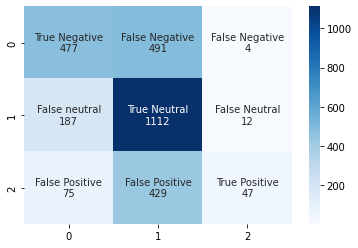

In [ ]:
cnf_matrix = confusion_matrix(y_test,svm_pred)
group_names = ['True Negative','False Negative','False Negative', 'False neutral', 'True Neutral', 'False Neutral', 'False Positive','False Positive','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in cnf_matrix.flatten()]
labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_names,group_counts)]
labels = np.asarray(labels).reshape(3,3)
sns.heatmap(cnf_matrix, annot=labels, fmt='', cmap='Blues');

## **OBSERVATIONS**

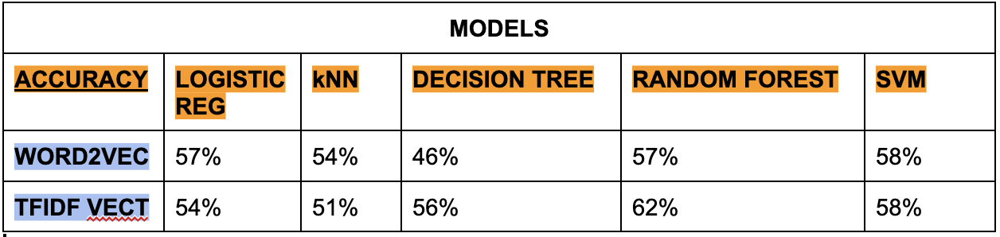

As a result, we don't find much difference in the results from the two types of vectorization. But with slightly being better, we choose tf-idf vectorisation as our final method. 

**Random Forest based on tf-idf vectorization is chosen as the final model**. 

# **UNSUPERVISED LEARNING**

In [ ]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
from sklearn.metrics import silhouette_score
# Import the Kernel PCA class
from sklearn.decomposition import KernelPCA

In [ ]:
# Building K means with k=3 as we have three classes

model_k=KMeans(n_clusters=3)
model_k.fit(tfidf_train_vectors)
train_prediction=model_k.predict(tfidf_train_vectors)
test_prediction=model_k.predict(tfidf_test_vectors)

In [ ]:
# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

 # Notice you start at 2 clusters for silhouette coefficient
for k in range(3, 15):
   kmeans = KMeans(n_clusters=k)
   kmeans.fit(tfidf_train_vectors)
   score = silhouette_score(tfidf_train_vectors, kmeans.labels_)
   silhouette_coefficients.append(score)

In [ ]:
silhouette_coefficients

[0.0047043695730645246,
 0.006135319077641096,
 0.006048624437343145,
 0.00766383231173335,
 0.008153331603176977,
 0.008695357351684255,
 0.009438123745726215,
 0.009976871805171431,
 0.01074585751927272,
 0.010570136930152735,
 0.01214724215063392,
 0.012592843556794665]

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


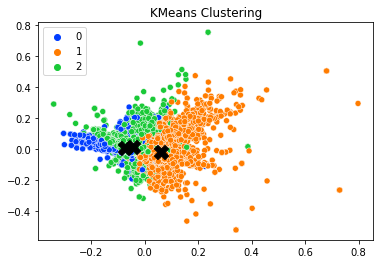

In [ ]:
pca = PCA(n_components = 0.9).fit(tfidf_train_vectors.toarray())
X_pca = pca.transform(tfidf_train_vectors.toarray())

kmeans = MiniBatchKMeans(init='k-means++', n_clusters=3, max_iter=500, n_init=10, 
                         random_state=777)
y_pred = kmeans.fit_predict(tfidf_train_vectors)

palette = sns.color_palette('bright', len(set(y_pred)))
sns.scatterplot(X_pca[:,0], X_pca[:, 1], hue=y_pred, legend='full', palette=palette)
plt.title('KMeans Clustering')

centers_on_PCs = pca.transform(kmeans.cluster_centers_)
plt.scatter(x=centers_on_PCs[:,0],y=centers_on_PCs[:,1],s=200,c="k",marker="X")

# **EXAMPLE OF HOW OUR MODEL PREDICTS**

In [ ]:
# Converting arrays to dataframes and concatenating 
prediction = pd.DataFrame(rf_pred, columns = ['Prediction'])
test_tweets = pd.DataFrame(x_test, columns = ['Tweet'])
true_class = pd.DataFrame(y_test, columns = ['Actual Class'])

In [ ]:
result = pd.concat([test_tweets, prediction, true_class], axis=1)

In [ ]:
result

,Tweet,Prediction,Actual Class
0,romney give hell speech lebanon ohio he real...,-1,1
1,mitt romney arrest use large block ice slide...,-1,-1
2,since self center obnoxious loveless people ...,-1,0
3,obama romney,0,0
4,gov romney easily debate hand,0,1
...,...,...,...
2829,dudebroman romney weak candidate face relati...,0,0
2830,coal miner fight back obama obamalies electi...,-1,0
2831,refuse part broken system give us choice rom...,0,0
2832,nd come george bush less sum rt still try fi...,-1,0


In [ ]:
index = int(input("Enter a number \n"))

Enter a number 
1


In [ ]:
index

1

In [ ]:
if index < 2834:
  print("Tweet selected: \n", result['Tweet'].loc[index])
  x = result['Prediction'].loc[index]
  if x == "-1":
    print("Result: The tweet is predicted to be of negative sentiment.")
    if result['Prediction'].loc[index] == result['Actual Class'].loc[index]:
      print("It matches the actual class.")
    else: 
      print("It does not matches the actual class.")
  elif x == "0":
    print(" Result: The tweet is predicted to be of neutral sentiment.")
    if result['Prediction'].loc[index] == result['Actual Class'].loc[index]:
      print("It matches the actual class.")
    else: 
      print("It does not matches the actual class.")
  else: 
    print("Result: The tweet is predicted to be of positive sentiment.")
    if result['Prediction'].loc[index] == result['Actual Class'].loc[index]:
      print("It matches the actual class.")
    else: 
      print("It does not matches the actual class.")
else: 
  print("Invalid entry")

Tweet selected: 
   mitt romney arrest use large block ice slide slope golf course hes go hell
Result: The tweet is predicted to be of positive sentiment.
It matches the actual class.
